In [1]:
%config InlineBackend.figure_format='retina'

In [2]:
from copy import deepcopy
import warnings
warnings.filterwarnings("ignore")

In [4]:
import numpy as np
import pandas as pd

pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', 50)

import matplotlib.pyplot as plt
import seaborn as sns

from tensorflow import keras

# Загрузка данных

## Сенсоры

In [5]:
from datetime import datetime

FebrauryData = pd.read_csv("../Probe_Data/SensorsData_Febraury.csv", index_col=0).iloc[::60, :17]
FebrauryData.index = np.array(
    ([datetime.strptime(d[:-7], '%d.%m.%Y %H:%M:%S') for d in FebrauryData.index]),
    dtype='datetime64[ns]')

MarchData = pd.read_csv("../Probe_Data/SensorsData_March.csv", index_col=0).iloc[::30, :17]
MarchData.index = np.array(
    ([datetime.strptime(d[:-7], '%d.%m.%Y %H:%M:%S') for d in MarchData.index]),
    dtype='datetime64[ns]')

MayData = pd.read_csv("../Probe_Data/SensorsData_May.csv", index_col=0).iloc[::1, :17]
MayData.index = np.array(
    ([datetime.strptime(d[:-7], '%d.%m.%Y %H:%M:%S') for d in MayData.index]),
    dtype='datetime64[ns]')

Data = pd.concat([FebrauryData, MarchData, MayData], axis=0)

In [6]:
Data.sort_index(inplace=True)
Data.to_csv("../Probe_Data/SensorsData_FebMarMay.csv")

In [7]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

import pandas as pd
sens_name_1 = Data.columns[12]
sens_name_2 = Data.columns[13]

Sens_1 = Data[sens_name_1].values
Sens_2 = Data[sens_name_2].values


fig = go.Figure()
fig.add_trace(go.Scatter(x=Data.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Data.index, y=Sens_2, name="Вибрация ЗПД (рад.)"))



#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)

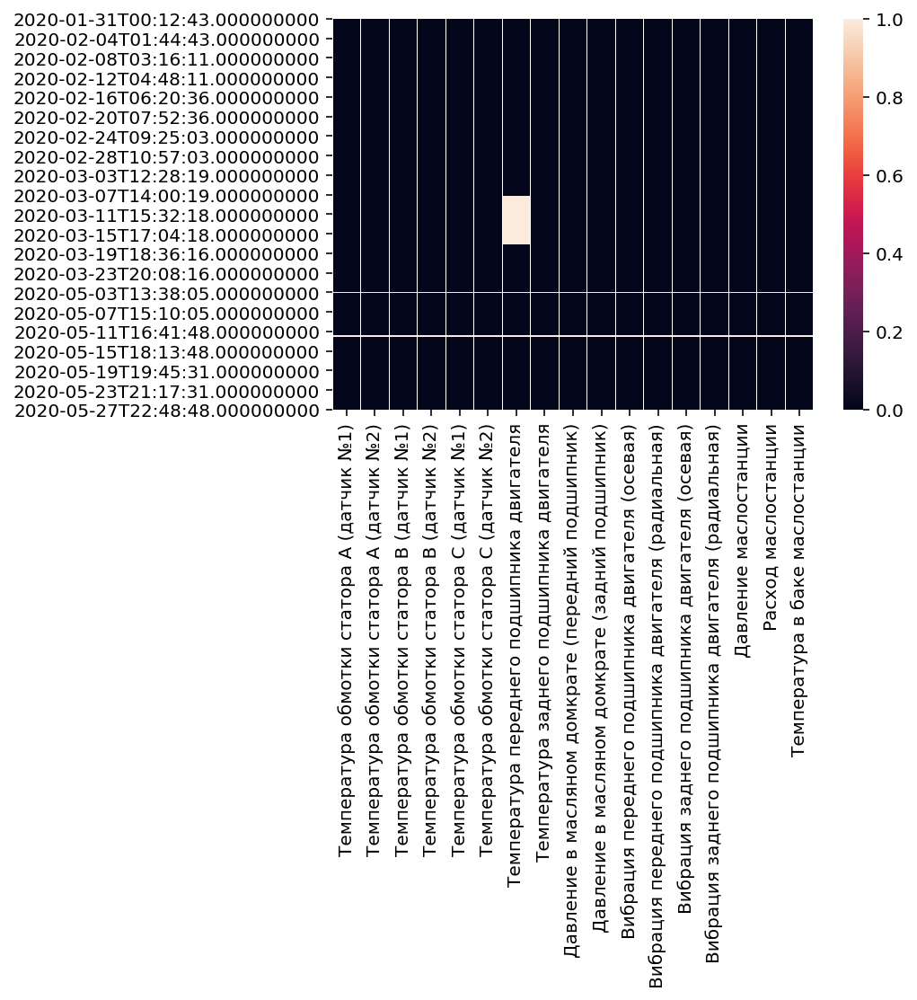

In [8]:
sns.heatmap(Data.isna())

In [11]:
from sklearn.impute import SimpleImputer

Data.dropna(how='all', inplace=True)
imputer = SimpleImputer()
Data = pd.DataFrame(imputer.fit_transform(Data), index=Data.index, columns=Data.columns)

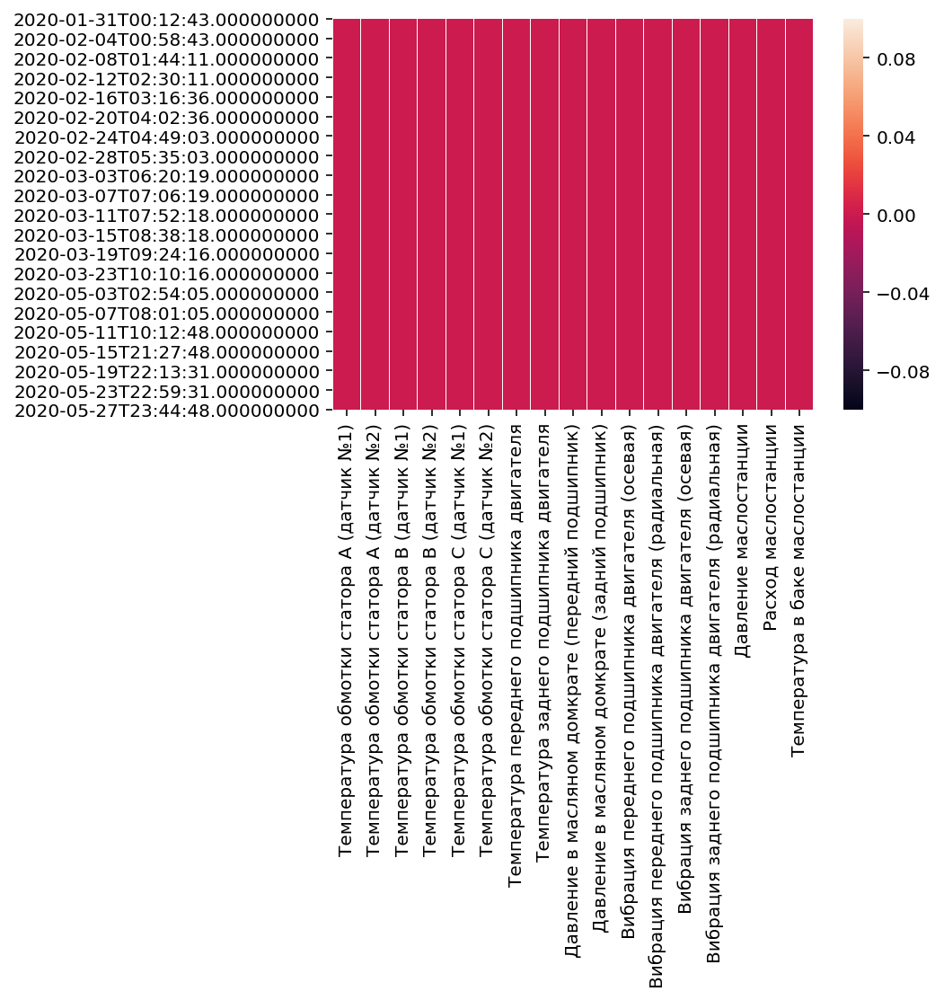

In [10]:
sns.heatmap(Data.isna())

## Остановки

In [12]:
# StopLogs data

stops_data = pd.read_csv("../Probe_Data/Jan_to_Jun_StopLogs.csv")
stops_data['start_datetime'] = stops_data.start_datetime.astype('datetime64[ns]')
stops_data['end_datetime'] = stops_data.end_datetime.astype('datetime64[ns]')

## Таргет

In [13]:
# Берем таргет из журнальных данных

Data['target'] = 0
Data['target_dscr'] = "Норма"

for start, end, dscr in stops_data[np.invert(stops_data.description.isin([
        "Технологические плановые : Межплавочный период",
        ]))]\
        [['start_datetime', 'end_datetime', 'description']].values:
    
    Data['target'][(Data.index >= start) & (Data.index <= end)] = 1
    Data['target_dscr'][(Data.index >= start) & (Data.index <= end)] = dscr

In [14]:
# Добавляем таргет по минимумам вибрации

Data["target"][(Data["Вибрация заднего подшипника двигателя (осевая)"] < 15.0)
             & (Data["Вибрация заднего подшипника двигателя (радиальная)"] < 15.0)] = 1

In [15]:
def SetShiftTarget(Data, delta):
    """
    Сдвигает изначальный таргет на delta шагов назад
    Шаг дискретизации по времени : 5 минут
    """
    Data["shift_target"] = deepcopy(Data.target.shift(-delta, fill_value=0).values)
    Data["shift_target"] = Data.shift_target.astype(int)
    return Data

In [16]:
# Смещаем на 180 шагов (здесь минут) = 3 часа

Data = SetShiftTarget(Data, 180)

X = Data.drop(['target', 'target_dscr', 'shift_target'], axis=1)
y = Data['shift_target']

X_to_vis = Data.drop(['target', 'target_dscr', 'shift_target'], axis=1)
y_to_vis = Data['shift_target']

#========================================================================

from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer

# Normalize X
mms = MinMaxScaler(feature_range=(-1,1))
imputer = SimpleImputer()

X = pd.DataFrame(mms.fit_transform(imputer.fit_transform(X)),
                 index=X.index,
                 columns=X.columns)

X_to_vis = pd.DataFrame(mms.fit_transform(imputer.fit_transform(X_to_vis)),
                        index=X_to_vis.index,
                        columns=X_to_vis.columns)

# Предобработка

## Генерация фичей

### Попарные корреляции

In [17]:
WINDOW_SIZE = 120

corr_X = X.rolling(window = WINDOW_SIZE).corr()

In [18]:
from itertools import product, combinations
from tqdm.notebook import tqdm

Sensors_Combs = list(combinations(X.columns, r=2))
CorrFeatures = pd.DataFrame()

for sens_1, sens_2 in tqdm(Sensors_Combs):

    # Выбираем из датафрейма, корреляцию за все время пары датчиков `sens_1` и `sens_2`
    corr_series = corr_X[sens_1].loc[:, sens_2]

    # Так как использовалась оконная функция в начале есть пропуски
    # Заполним их случайными величинами из диапазона [MIN, MAX] для данного ряда
    MAX, MIN = corr_series.max(), corr_series.min()
    fill_values = np.random.sample(size=WINDOW_SIZE) * (MAX - MIN) + MIN
    corr_series[:WINDOW_SIZE] = fill_values

    # Все такие новые колонки с попарными корреляциями датчиков
    # Будут начинаться с `Corr_`
    corr_series.name = '_'.join(['Corr', sens_1, sens_2])

    CorrFeatures = pd.concat([CorrFeatures, corr_series], axis=1)

In [19]:
CorrFeatures.dropna(how="any", inplace=True)
CorrFeatures.replace(np.inf, 1, inplace=True)
CorrFeatures.replace(-np.inf, -1, inplace=True)

In [20]:
mms = MinMaxScaler()

CorrFeatures = pd.DataFrame(mms.fit_transform(CorrFeatures),
                            index=CorrFeatures.index,
                            columns=CorrFeatures.columns)

## Объединение

In [21]:
imputer = SimpleImputer()
X = pd.DataFrame(imputer.fit_transform(pd.concat([X, CorrFeatures], axis=1)),
                 index = X.index,
                 columns = X.columns.to_list() + CorrFeatures.columns.to_list())

## Multiplication features : to CNN

The multiplication method is proposed in this work to create more heterogeneous image-like data representation. These heterogeneous patterns in the image representation can help the creation of different filters by the CNN model, increasing its ability to correctly classify the data as normal or faulty. Given the example $d = \{f_1, f_2, …, f_n \}$, the transformed example $D_m$ is given by a matrix created by the multiplication of the $f_i$ features by the whole example $d$, as presented by Equation 5:

$$\begin{equation*}D_{m}=\begin{bmatrix}{f_{1} \cdot f_{1}} & {f_{1} \cdot f_{2}} & {\cdots} & {f_{1} \cdot f_{n}} \\ {f_{2} \cdot f_{1}} & {f_{2} \cdot f_{2}} & {\ddots} & {f_{2} \cdot f_{n}} \\ {\vdots} & {\vdots} & {\ddots} & {\vdots} \\ {f_{n} \cdot f_{1}} & {f_{n} \cdot f_{2}} & {\cdots} & {f_{n} \cdot f_{n}}\end{bmatrix} \tag{5}\end{equation*}$$

In [113]:
from tqdm.notebook import tqdm
from sklearn.preprocessing import MinMaxScaler

def get_X_for_CNN(X):
    
    X_vals = X.values.reshape(*X.shape, 1)
    mms = MinMaxScaler()
    X_to_CNN = np.array([mms.fit_transform(ex @ ex.T) for ex in tqdm(X_vals)], dtype=float)
    
    return X_to_CNN.reshape(-1, *X_to_CNN.shape[1:], 1)

def batch_generator(X, y, batch_size):
    samples_per_epoch = X.shape[0]
    number_of_batches = samples_per_epoch/batch_size
    counter=0
    
    X_vals = X.values.reshape(*X.shape, 1)
    y_vals = y.values
    mms = MinMaxScaler()

    
    while True:
        X_batch = X_vals[batch_size*counter : batch_size*(counter+1)].astype('float32')
        X_to_CNN_batch = np.array([mms.fit_transform(ex @ ex.T) for ex in X_batch], dtype=float)
        y_batch = np.array(y_vals[batch_size*counter:batch_size*(counter+1)]).astype('float32')
        counter += 1
        yield X_to_CNN_batch.reshape(-1,153,153,1), y_batch

        #restart counter to yeild data in the next epoch as well
        if counter >= number_of_batches:
            counter = 0

In [114]:
# from copy import deepcopy

# X_to_CNN = get_X_for_CNN(X)
# y_to_CNN = y.values.astype(int)

# Модель

In [115]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, BatchNormalization

n_hidden_convs = 3
num_filters = 7
filter_size = 3


# def create_model(n_hidden_convs = n_hidden_convs,
#                  n_hidden_filters = num_filters,
#                  kernel_size = filter_size):

#     model = Sequential()
#     model.add(
#         Conv2D(n_hidden_filters,
#                kernel_size,
#                padding='same',
#                activation='tanh',
#                input_shape=X_to_CNN.shape[1:]))
#     for i in range(n_hidden_convs):
#         model.add(
#             Conv2D(n_hidden_filters,
#                    kernel_size,
#                    padding='same',
#                    activation='tanh'))
#     model.add(Conv2D(1, kernel_size, padding='same', activation='tanh'))
#     model.add(MaxPooling2D(2)),
#     model.add(Flatten())
#     model.add(Dense(2, activation='softmax'))

#     model.compile(
#         'adam',
#         loss='categorical_crossentropy',
#         metrics=['accuracy', 'AUC'],
#     )

#     return model


# model = create_model()

#=============================================================================


def create_model(n_hidden_filters = num_filters,
                 kernel_size = filter_size):
    
    model = Sequential([
        Conv2D(n_hidden_filters, kernel_size, input_shape=(153,153,1)),
        Conv2D(n_hidden_filters, kernel_size),
        Flatten(),
        Dense(1, activation='sigmoid'),
    ])

    model.compile(
        'adam',
        loss='binary_crossentropy',
        metrics=['accuracy', 'AUC'],
    )

    return model

## Обучение

In [116]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    test_size=0.33,
                                                    random_state=42,
                                                    shuffle=False)

In [ ]:
model.predict_generator()

In [117]:
from tensorflow.keras.utils import to_categorical

model = create_model(n_hidden_filters=3, kernel_size=3)

# history = model.fit(X_train,
#                     y_train,
#                     batch_size=180,
#                     epochs=5,
#                     validation_data=(X_test, y_test),
#                     shuffle=False)

BATCH_SIZE = 120

history = model.fit_generator(batch_generator(X, y, batch_size=BATCH_SIZE),
                              epochs=10,
                              steps_per_epoch=X.shape[0] // BATCH_SIZE,
                              validation_data=batch_generator(X, y, batch_size=BATCH_SIZE*2),
                              validation_steps=X.shape[0] // BATCH_SIZE*2)

Epoch 1/10
1015/1015 [==============================] - 992s 978ms/step - loss: 0.7696 - accuracy: 0.8738 - auc: 0.5290 - val_loss: 0.4298 - val_accuracy: 0.8373 - val_auc: 0.6122
Epoch 2/10
1015/1015 [==============================] - 1037s 1s/step - loss: 0.5066 - accuracy: 0.8872 - auc: 0.5841 - val_loss: 0.4619 - val_accuracy: 0.8088 - val_auc: 0.6507
Epoch 3/10
 924/1015 [==========================>...] - ETA: 1:03 - loss: 0.3993 - accuracy: 0.9187 - auc: 0.5896

KeyboardInterrupt: 